In [1]:
import matplotlib.pyplot as plt
from PIL import Image
from typing import List, Optional
import argparse
import ast
from pathlib import Path
from diffusers import DiffusionPipeline, UNet2DConditionModel, LCMScheduler, AutoencoderTiny
from huggingface_hub import hf_hub_download
import gc
import torch.nn.functional as F
import os, glob
import torch
from tqdm.auto import tqdm
import time, datetime
import numpy as np
from torch.optim import AdamW
from contextlib import ExitStack
from safetensors.torch import load_file
import torch.nn as nn
import random
from transformers import CLIPModel
import sys
sys.path.append('../')
from utils.lora import LoRANetwork, DEFAULT_TARGET_REPLACE, UNET_TARGET_REPLACE_MODULE_CONV
from utils.inference_util import StableDiffusionXLPipelineSliders
from transformers import logging
logging.set_verbosity_warning()

from diffusers import logging
logging.set_verbosity_error()
modules = DEFAULT_TARGET_REPLACE
modules += UNET_TARGET_REPLACE_MODULE_CONV

/home/cge7/.conda/envs/sliderspace_env/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
repo_name = "tianweiy/DMD2"
ckpt_name = "dmd2_sdxl_4step_unet_fp16.bin"

device = 'cuda:0'
weight_dtype = torch.bfloat16

# --- CHANGE 1: Match the --num_sliders 10 from your training script ---
numsliders_to_sample = 10 

# Load base model
unet = UNet2DConditionModel.from_config(base_model_id, subfolder="unet").to(device, weight_dtype)

# Load the DMD2 weights (Since you used --distilled_ckpt "dmd2")
unet.load_state_dict(torch.load(hf_hub_download(repo_name, ckpt_name)))

# Initialize Pipeline
pipe = StableDiffusionXLPipelineSliders.from_pretrained(base_model_id, unet=unet, torch_dtype=weight_dtype)
pipe.scheduler = LCMScheduler.from_config(pipe.scheduler.config)

pipe = pipe.to(device).to(weight_dtype)
unet = pipe.unet

## Change these parameters based on how you trained your sliderspace sliders
train_method = 'xattn-strict' # This is the default in train_sdxl.py
rank = 1 
alpha = 1 
print(f"Rank: {rank}, Alpha: {alpha}, Method: {train_method}")

# Initialize the LoRA Networks for all 10 sliders
networks = {}
modules = DEFAULT_TARGET_REPLACE
modules += UNET_TARGET_REPLACE_MODULE_CONV

for i in range(numsliders_to_sample):
    networks[i] = LoRANetwork(
        unet,
        rank=int(rank),
        multiplier=1.0,
        alpha=int(alpha),
        train_method=train_method,
        fast_init=True,
    ).to(device, dtype=weight_dtype)
    
print(f"Initialized {len(networks)} empty LoRA networks ready for loading.")

/home/cge7/.conda/envs/sliderspace_env/lib/python3.10/site-packages/diffusers/configuration_utils.py:245: FutureWarning: It is deprecated to pass a pretrained model name or path to `from_config`.If you were trying to load a model, please use <class 'diffusers.models.unets.unet_2d_condition.UNet2DConditionModel'>.load_config(...) followed by <class 'diffusers.models.unets.unet_2d_condition.UNet2DConditionModel'>.from_config(...) instead. Otherwise, please make sure to pass a configuration dictionary instead. This functionality will be removed in v1.0.0.
  deprecate("config-passed-as-path", "1.0.0", deprecation_message, standard_warn=False)


/tmp/ipykernel_2950116/3193572357.py:15: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  unet.load_state_dict(torch.load(hf_hub_download(repo_name, ckpt_name)))
Loading pipeli

Rank: 1, Alpha: 1, Method: xattn-strict
create LoRA for U-Net: 140 modules.
create LoRA for U-Net: 140 modules.
create LoRA for U-Net: 140 modules.
create LoRA for U-Net: 140 modules.
create LoRA for U-Net: 140 modules.
create LoRA for U-Net: 140 modules.
create LoRA for U-Net: 140 modules.
create LoRA for U-Net: 140 modules.
create LoRA for U-Net: 140 modules.
create LoRA for U-Net: 140 modules.
Initialized 10 empty LoRA networks ready for loading.


# Iterate through every slider you discovered and visualize

Found 10 sliders. Visualizing...


/tmp/ipykernel_2950116/4055645307.py:25: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(slider)


100%|██████████| 4/4 [00:00<00:00, 11.34it/s]


Visualizing: slider_0.pt


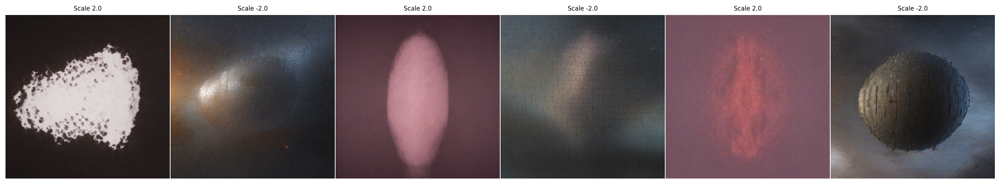

100%|██████████| 4/4 [00:00<00:00, 11.42it/s]


Visualizing: slider_1.pt


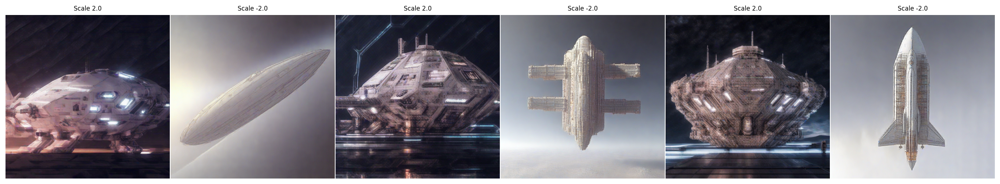

100%|██████████| 4/4 [00:00<00:00, 11.28it/s]


Visualizing: slider_2.pt


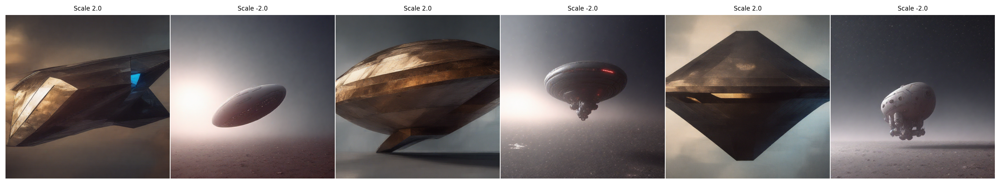

100%|██████████| 4/4 [00:00<00:00, 11.40it/s]


Visualizing: slider_3.pt


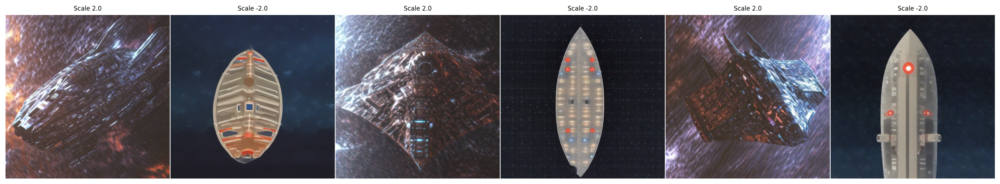

100%|██████████| 4/4 [00:00<00:00, 11.39it/s]


Visualizing: slider_4.pt


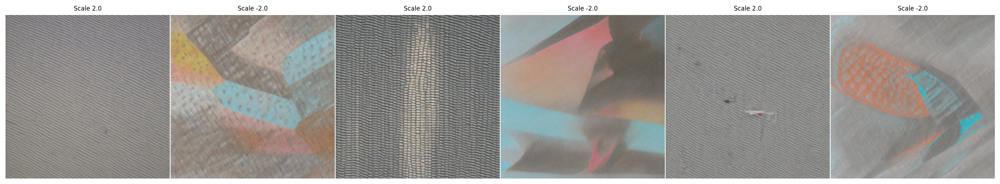

100%|██████████| 4/4 [00:00<00:00, 11.55it/s]


Visualizing: slider_5.pt


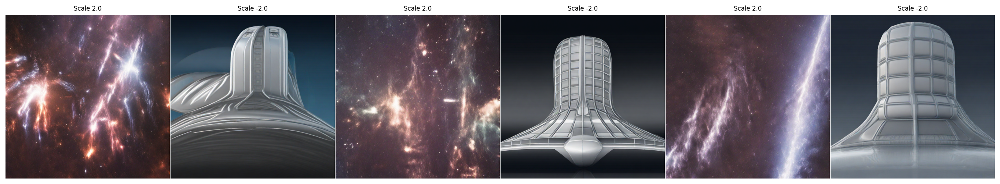

100%|██████████| 4/4 [00:00<00:00, 11.43it/s]


Visualizing: slider_6.pt


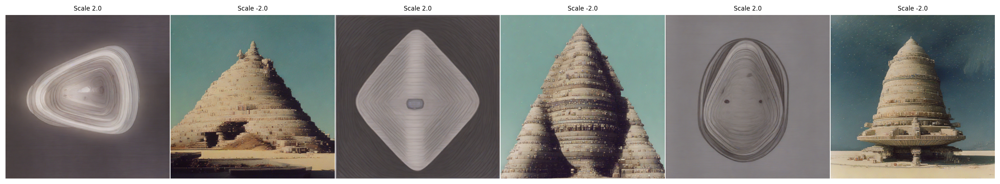

100%|██████████| 4/4 [00:00<00:00, 11.24it/s]


Visualizing: slider_7.pt


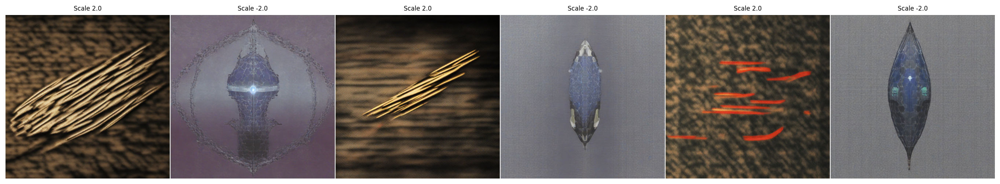

100%|██████████| 4/4 [00:00<00:00, 10.94it/s]


Visualizing: slider_8.pt


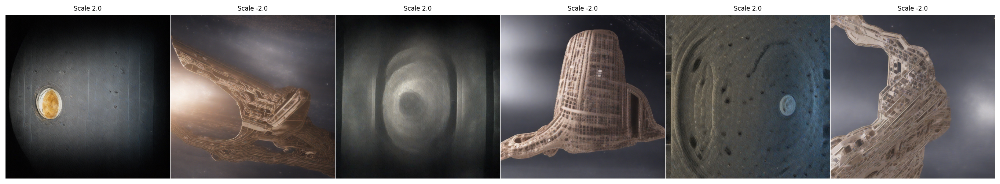

100%|██████████| 4/4 [00:00<00:00, 11.39it/s]


Visualizing: slider_9.pt


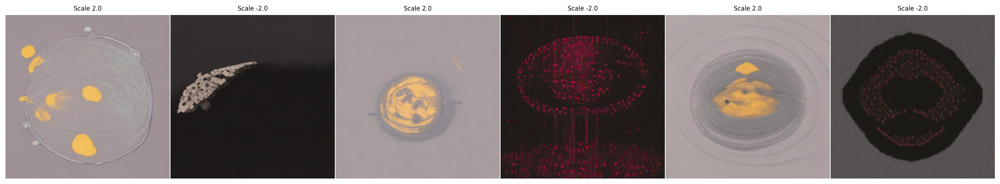

In [4]:
import glob
import random
import os
import matplotlib.pyplot as plt

# --- 1. CONFIG UPDATES ---
prompt = "picture of a spaceship"  # MUST match your training prompt
sliderspace_path = '../trained_sliders/sdxl/spaceship_discovery/' # Update if folder name differs
slider_scales = [2.0, -2.0] # Recommend testing Positive AND Negative
num_images = 3 # Number of random seeds to test per slider

# Find all slider files
sliderspace = sorted(glob.glob(f'{sliderspace_path}/*.pt'))

# --- 2. UNCOMMENTED SEEDS ---
seeds = [random.randint(0,2**15) for _ in range(num_images)]

print(f"Found {len(sliderspace)} sliders. Visualizing...")

for slider_idx, slider in enumerate(sliderspace):
    image_list = []
    
    # --- 3. CRITICAL FIX: LOAD INTO ONE SLOT ONLY ---
    # We load the weights into the first network slot only
    state_dict = torch.load(slider)
    networks[0].load_state_dict(state_dict)
    
    # Create a temporary dict with ONLY this network active
    # This prevents the pipe from summing up 10 empty/duplicate networks
    active_networks = {0: networks[0]}

    for im in range(num_images):
        seed = seeds[im]
        for scale in slider_scales:
            
            # Set scale on the single active network
            active_networks[0].set_lora_slider(scale)
            
            generator = torch.manual_seed(seed)

            # Pass 'active_networks', NOT 'networks'
            images = pipe(
                prompt, 
                num_images_per_prompt=1, 
                num_inference_steps=4, 
                guidance_scale=0, 
                generator=generator,
                networks=active_networks, # <--- Fix applied here
                apply_sliders_from=0, 
                apply_sliders_till=None
            ).images[0]
            
            image_list.append(images)

    # Plotting
    slider_name = os.path.basename(slider)
    print(f"Visualizing: {slider_name}")
    
    fig, ax = plt.subplots(1, len(image_list), frameon=False, dpi=150)
    fig.set_size_inches(len(image_list) * 3, 3) 

    # Handle case where only 1 image is generated (ax is not iterable)
    if len(image_list) == 1: ax = [ax]

    for i, a in enumerate(ax):
        a.imshow(image_list[i])
        a.axis('off')
        # Add label to see which is pos/neg
        scale_label = slider_scales[i % len(slider_scales)]
        a.set_title(f"Scale {scale_label}", fontsize=8)

    plt.tight_layout(pad=0)
    plt.show()

In [7]:
import glob
import os
import torch
import matplotlib.pyplot as plt

# --- CONFIGURATION ---
prompt = "picture of a spaceship" 
# Update this path if your folder name is different (e.g., check your file explorer)
sliderspace_path = '../trained_sliders/sdxl/spaceship_discovery/' 
slider_scales = [2.0, -2.0]  # Testing Positive vs Negative
num_seeds = 1 # How many random variations to generate per slider

# Get all slider files
sliders = sorted(glob.glob(f'{sliderspace_path}/*.pt'))
print(f"Found {len(sliders)} sliders in {sliderspace_path}")

# Generate a fixed seed list so comparisons are fair
seeds = [random.randint(0, 2**15) for _ in range(num_seeds)]

# --- GENERATION LOOP ---
for idx, slider_file in enumerate(sliders):
    print(f"Processing Slider {idx}: {os.path.basename(slider_file)}...")
    
    # 1. Load weights into the FIRST network slot only
    # We ignore the other 9 slots to prevent the "Chorus Effect"
    state_dict = torch.load(slider_file)
    networks[0].load_state_dict(state_dict)
    
    # 2. Create a temporary dict with ONLY this network active
    active_networks = {0: networks[0]}
    
    image_list = []
    label_list = []

    # 3. Generate Images
    for seed in seeds:
        generator = torch.manual_seed(seed)
        for scale in slider_scales:
            # Set strength
            active_networks[0].set_lora_slider(scale)
            
            # Run Inference
            with torch.no_grad():
                images = pipe(
                    prompt, 
                    num_images_per_prompt=1, 
                    num_inference_steps=4, 
                    guidance_scale=0,    
                    generator=generator,
                    networks=active_networks, # <--- IMPORTANT: Pass only the single active slot
                    apply_sliders_from=0, 
                    apply_sliders_till=None
                ).images[0]
            
            image_list.append(images)
            label_list.append(f"Scale {scale}")

    # 4. Save to Disk (Bypassing VS Code Renderer)
    # Create a figure
    fig, ax = plt.subplots(1, len(image_list), frameon=False, dpi=150)
    fig.set_size_inches(len(image_list) * 4, 4)
    
    # Handle single image case
    if len(image_list) == 1: ax = [ax]

    for i, a in enumerate(ax):
        a.imshow(image_list[i])
        a.axis('off')
        a.set_title(label_list[i], fontsize=12)

    plt.tight_layout(pad=0.5)
    
    # Save the file
    save_filename = f"grid_slider_{idx}.png"
    plt.savefig(save_filename)
    plt.close(fig) # Clear memory
    
    print(f"--> Saved: {save_filename}")

print("\nDone! Check your file explorer for the 'grid_slider_X.png' files.")

Found 10 sliders in ../trained_sliders/sdxl/spaceship_discovery/
Processing Slider 0: slider_0.pt...


/tmp/ipykernel_2950116/3746513559.py:26: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(slider_file)
100%|██████████| 4/4 [00:00<00:00,  8.95it/s]


--> Saved: grid_slider_0.png
Processing Slider 1: slider_1.pt...


100%|██████████| 4/4 [00:00<00:00, 11.30it/s]


--> Saved: grid_slider_1.png
Processing Slider 2: slider_2.pt...


100%|██████████| 4/4 [00:00<00:00, 11.53it/s]


--> Saved: grid_slider_2.png
Processing Slider 3: slider_3.pt...


100%|██████████| 4/4 [00:00<00:00, 11.37it/s]


--> Saved: grid_slider_3.png
Processing Slider 4: slider_4.pt...


100%|██████████| 4/4 [00:00<00:00, 11.30it/s]


--> Saved: grid_slider_4.png
Processing Slider 5: slider_5.pt...


100%|██████████| 4/4 [00:00<00:00, 10.74it/s]


--> Saved: grid_slider_5.png
Processing Slider 6: slider_6.pt...


100%|██████████| 4/4 [00:00<00:00, 11.36it/s]


--> Saved: grid_slider_6.png
Processing Slider 7: slider_7.pt...


100%|██████████| 4/4 [00:00<00:00, 10.81it/s]


--> Saved: grid_slider_7.png
Processing Slider 8: slider_8.pt...


100%|██████████| 4/4 [00:00<00:00, 11.42it/s]


--> Saved: grid_slider_8.png
Processing Slider 9: slider_9.pt...


100%|██████████| 4/4 [00:00<00:00, 11.30it/s]


--> Saved: grid_slider_9.png

Done! Check your file explorer for the 'grid_slider_X.png' files.


# Make Gifs by sliding the slider scales

In [ ]:
def generate_smooth_gif(
    pipe,
    networks,
    prompt,
    slider_path,
    num_frames=30,
    scale_start=0,
    scale_end=2,
    seed=None,
    output_path="interpolation.gif",
    fps=10,
    dpi=300,
):
    if seed is not None:
        random.seed(seed)
        torch.manual_seed(seed)
    
    for net in networks:
        networks[net].load_state_dict(torch.load(slider_path))
    
    # Simple linear interpolation for forward frames
    scales = np.linspace(scale_start, scale_end, num_frames)
    
    images = []
    seed = random.randint(0, 2**15)
    pipe.set_progress_bar_config(disable=True)
    
    for scale in tqdm(scales):
        for net in networks:
            networks[net].set_lora_slider(float(scale))
        
        generator = torch.manual_seed(seed)

        image = pipe(
            prompt,
            num_images_per_prompt=1,
            num_inference_steps=4,
            guidance_scale=0,
            generator=generator,
            networks=networks,
             # FROM WHAT TIMESTEP OF TOTAL INFERENE STEPS DO YOU wANT TO APPLY SLIDER? 
             # INCREASE TO HAVE MORE PRECISE EDITS 
             # (NOTE: FOR DISTILLED MODELS IT MIGHT NOT SHOW FULL SLIDER CAPACITY DUE TO THE FIRST TIMESTEP BEING SO POWERFUL)
             apply_sliders_from=1, 
             apply_sliders_till=None, # LEAVE THIS NONE. UNLESS YOU WANT TO SKIP APPLYING SLIDER AT FINAL TIMESTEPS?
        ).images[0]
            
        if not isinstance(image, Image.Image):
            image = Image.fromarray(np.uint8(image))
        
        # Resize image while maintaining aspect ratio
        image.thumbnail((256, 256), Image.Resampling.LANCZOS)
        images.append(image)
    
    duration = 1000 / fps  # Convert fps to milliseconds
    images[0].save(
        output_path,
        save_all=True,
        append_images=images[1:],
        duration=duration,
        loop=0,
        optimize=True,
        quality=70,
        dpi=dpi
    )
    pipe.set_progress_bar_config(disable=False)
    return images

In [ ]:
# sliderspace_path = '../trained_sliders/sdxl/ancient ruins/'
# prompt = 'picture of a ancient ruin'

slider_scale_start = 0 
slider_scale_end = 2

num_frames = 50 # how many scales you want to interpolate between the start and end scale
num_images = 2
    
sliderspace = glob.glob(f'{sliderspace_path}/*.pt')
gifs_path = sliderspace_path.replace('trained_sliders','gifs')

os.makedirs(gifs_path, exist_ok=True)

seeds = [random.randint(0, 2**15) for _ in range(num_images)]
print(seeds)

for slider_idx, slider in enumerate(sliderspace):
    slider_number = int(os.path.basename(slider).split('.')[0].split('_')[-1])

    print(os.path.basename(slider))
    for seed in seeds:
        
        output_filename = f"{gifs_path}/{os.path.basename(slider).replace('.pt','_'+str(seed)+'.gif')}"
        
        images = generate_smooth_gif(
            pipe=pipe,
            networks=networks,
            prompt=prompt,
            slider_path=slider,
            num_frames=num_frames,  # Adjust for smoother/faster interpolation
            scale_start=slider_scale_start,
            scale_end=slider_scale_end,
            output_path=output_filename,
            seed = seed,
            fps=20  # Adjust for slower/faster playback
        )
        
        # Optional: Display first and last frame for verification
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))
        ax1.imshow(images[0])
        ax1.set_title("Start (Scale = 0)")
        ax1.axis('off')
        ax2.imshow(images[-1])
        ax2.set_title("End (Scale = 1)")
        ax2.axis('off')
        plt.show()

# Generate Images with Multiple Sliders Composed

## Make sure that you initialized more than 1 slider 


In [ ]:
prompt = 'picture of a spaceship'
sliderspace_path = '../trained_sliders/spaceship/'

slider_scale = 1
num_images = 10
sliderspace = glob.glob(f'{sliderspace_path}/*.pt')
image_list = []
for idx in range(num_images):
    seed = random.randint(0,2**15)
    generator = torch.manual_seed(seed)
    sliderspace_samples = random.sample(sliderspace, numsliders_to_sample)
    for i, net in enumerate(networks):
        networks[net].load_state_dict(torch.load(sliderspace_samples[i]))
        networks[net].set_lora_slider(slider_scale)
        with networks[net]:
            pass
        
    with ExitStack() as es:
        for net in networks:
            es.enter_context(networks[net])
        images = pipe(prompt, num_images_per_prompt=1, num_inference_steps=4, guidance_scale=0, generator=generator,
                     networks=networks,
                     # FROM WHAT TIMESTEP OF TOTAL INFERENE STEPS DO YOU wANT TO APPLY SLIDER? 
                     # INCREASE TO HAVE MORE PRECISE EDITS 
                     # (NOTE: FOR DISTILLED MODELS IT MIGHT NOT SHOW FULL SLIDER CAPACITY DUE TO THE FIRST TIMESTEP BEING SO POWERFUL)
                     apply_sliders_from=1, 
                     apply_sliders_till=None, # LEAVE THIS NONE. UNLESS YOU WANT TO SKIP APPLYING SLIDER AT FINAL TIMESTEPS?).images[0]
                     ).images[0]
    image_list.append(images)

print('Randomly Sampled and Composed Sliders')
fig, ax = plt.subplots(1, len(image_list),frameon=False, dpi=600)
for i, a in enumerate(ax):
    a.imshow(image_list[i])
    a.axis('off')

plt.subplots_adjust(wspace=0, hspace=0)
plt.show()